In [2]:
import sys

sys.path.append('/home/labs/amit/noamsh/repos/MM_2023')

In [2]:
from pathlib import Path

from omegaconf import OmegaConf
import anndata as ad
import scanpy as sc

from sc_classification.train_test_split import split_adata

In [3]:
# load configuration

In [4]:
config_path = '/home/labs/amit/noamsh/repos/MM_2023/config.yaml'
conf = OmegaConf.load(config_path)

In [5]:
# load adata - if does not exist run pp_adata.py

In [6]:
adata_path = Path(conf.outputs.output_dir, conf.outputs.processed_adata_file_name)
adata = ad.read_h5ad(adata_path)

In [7]:
adata

AnnData object with n_obs × n_vars = 398208 × 57874
    obs: 'Amp.Batch.ID', 'Seq.Batch.ID', 'Batch.Set.ID', 'Member', 'Description', 'Included', 'Tissue', 'Gating', 'Total.PC', 'Total.NonPC', 'Initial.Code', 'Disease', 'Project', 'Cohort', 'Weizmann.Code', 'Hospital.Code', 'Unnamed: 0', 'type', 'amp_batch_id', 'seq_batch_id', 'batch_set_id', 'Member_annotation', 'Description_annotation', 'Included_annotation', 'Tissue_annotation', 'Gating_annotation', 'Total.PC_annotation', 'Total.NonPC_annotation', 'Initial.Code_annotation', 'Disease_annotation', 'Project_annotation', 'Cohort_annotation', 'Weizmann.Code_annotation', 'Hospital.Code_annotation', 'spike_count', 'Annotation'

In [8]:
# split adata to train and test

In [15]:
adata_train, adata_test = split_adata(adata, split_by_obs_column=conf.annotation.patient_id_column_name)

# exploration - of raw data
Disease
    - it is equal to Disease
    - "Healty" and "Healthy " values
    - what is "nan" value? - We should ignor
    - that is MM unknow? - dont know stage
Annotation
    - most are LowQ
    - Adipocytes and Erythrocytes out of test

In [59]:
import  pandas as pd
pd.testing.assert_series_equal(adata.obs.Cohort, adata.obs.Disease, check_names=False)

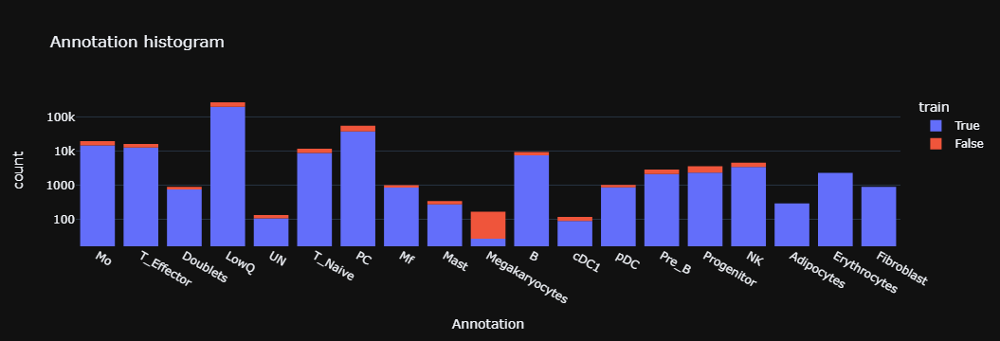

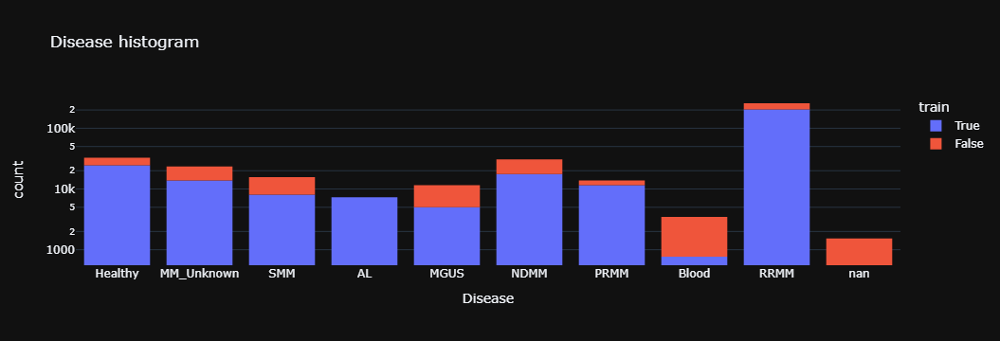

In [23]:
import plotly.express as px
for column_name in ['Annotation', 'Disease']:
    fig = px.histogram(adata.obs, x=column_name, log_y=True, title=f"{column_name} histogram", color="train")
    fig.show()


In [20]:
adata.obs["LowQ"] = adata.obs.Annotation == "LowQ"

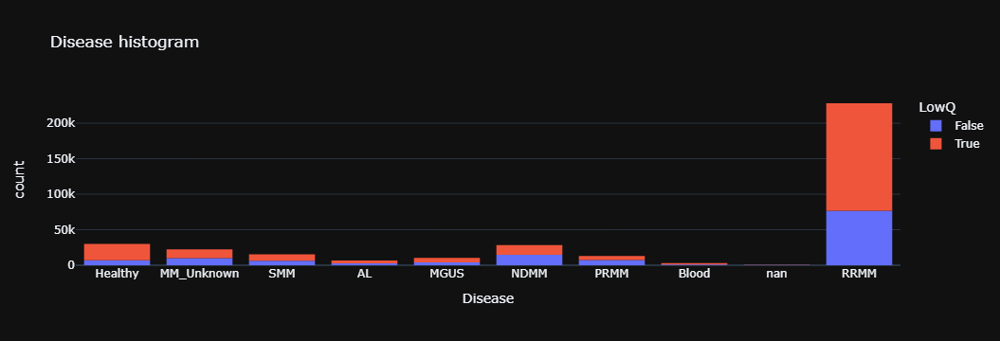

In [31]:
column_name = 'Disease'
fig = px.histogram(adata.obs, x=column_name, log_y=False, title=f"{column_name} histogram", color="LowQ")
fig.show()

In [ ]:
## clean Disease column